<a href="https://colab.research.google.com/github/haaden/Hello-world/blob/master/MSDS498_ESGreportDATA_BERTTOPIC_TOP2VEC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd


In [ ]:
pip install PyPDF2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.6/232.6 kB 5.7 MB/s eta 0:00:00


In [ ]:
url = pd.read_excel("ESG_SASB_Link.xlsx")

In [ ]:
url.head(2)

,Company name,Industry,Sector,Country,Type of Document,Publication Year,URLs
0,104 Corp,Internet Media & Services,Technology & Communications,Taiwan,ESG Report,2022,http://corp.104.com.tw/assets/files/CSR/2021_1...
1,2W Energia SA,Wind Technology & Project Developers,Renewable Resources & Alternative Energy,Brazil,Relatório de Sustentabilidade,2022,https://2wenergia.com.br/wp-content/uploads/20...


In [ ]:
ESGreport = url[(url["Type of Document"]== "ESG Report") & (url["Country"]== "United States")&((url["Publication Year"]== 2023) | (url["Publication Year"]== 2022))]

In [ ]:
ESGreport= ESGreport.sort_values(["Company name","Publication Year"], ascending=[True, False]).drop_duplicates("Company name", keep="first")

In [ ]:
ESGreport[ESGreport["Company name"] =="AbbVie Inc"]

,Company name,Industry,Sector,Country,Type of Document,Publication Year,URLs
12,AbbVie Inc,Biotechnology & Pharmaceuticals,Health Care,United States,ESG Report,2023,https://www.abbvie.com/content/dam/abbvie-com2...


In [ ]:
URL  = url[i[0].str.endswith("pdf")].tolist()

SyntaxError: ignored

In [ ]:
ESGreport['URLs'].str.endswith("pdf").shape

(344,)

In [ ]:
SASB_index = url[(url["Type of Document"]== "SASB Index") & (url["Country"]== "United States")&((url["Publication Year"]== 2023) | (url["Publication Year"]== 2022))]

SASB_index = SASB_index.sort_values(["Company name","Publication Year"], ascending=[True, False]).drop_duplicates("Company name", keep="first")

SASB_index = SASB_index[SASB_index["URLs"].str.endswith("pdf") ] 

In [ ]:
SUS_report = url[(url["Type of Document"]== "Sustainability Report") & (url["Country"]== "United States")&((url["Publication Year"]== 2023) | (url["Publication Year"]== 2022))]

SUS_report = SUS_report.sort_values(["Company name","Publication Year"], ascending=[True, False]).drop_duplicates("Company name", keep="first")

SUS_report = SUS_report[SUS_report["URLs"].str.endswith("pdf") ] 

In [ ]:
del(links)

In [ ]:
url[0].strip(" ")

'https://www.agilent.com/about/esg/en/2021-agilent-esg-report.pdf\nhttps://s21.q4cdn.com/616071541/files/images/esg/aag-esg-report-2021.pdf\nhttps://esg.advanceauto.us/Home/default.aspx\nhttps://www.apple.com/environment/pdf/Apple_Environmental_Progress_Report_2022.pdf\nhttps://www.abbvie.com/content/dam/abbvie-dotcom/uploads/PDFs/societal-impact/abbvie-esg-action-report.pdf\nhttps://www.amerisourcebergen.com/-/media/assets/amerisourcebergen/pdf/AmerisourceBergen_2021_GS_ESG_reportingindex.pdf\nhttps://s29.q4cdn.com/396247436/files/doc_downloads/esg_reports/ABMD_ESG-Report_2022.pdf\nhttps://dam.abbott.com/en-us/documents/pdfs/abbott-citizenship/Abbott-2021-Global-Sustainability-Report.pdf\nhttps://www.accenture.com/us-en/about/company/integrated-reporting#Section-9\nhttps://www.adobe.com/content/dam/cc/en/corporate-responsibility/pdfs/Adobe-CSR-Report-2021.pdf\nhttps://www.analog.com/media/en/company-csr/2021-esg-report.pdf\nhttps://www.adm.com/4ac97d/globalassets/sustainability/sustai

In [ ]:
import requests
import PyPDF2
import io


def extract_content(url):

   
        
        # retrieve PDF binary stream
        try:
            response = requests.get(url, timeout= 3)
        except requests.exceptions.RequestException as e:  # This is the correct syntax
            next
        try:
            open_pdf_file = io.BytesIO(response.content)
            pdf = PyPDF2.PdfReader(open_pdf_file)
            #pdfFileObj = open(url, 'rb')
            #pdf = PyPDF2.PdfReader(pdfFileObj)

            # return concatenated content
            text = [pdf.pages[i].extract_text() for i in range(0, len(pdf.pages))]
            return "\n".join(text)
        except:
            next

In [ ]:
links = SUS_report["URLs"].tolist()

In [ ]:
len(links)

229

In [ ]:
text = []
for i in links:
    print(i)
    text.append(extract_content(i))

In [ ]:
import gc
gc.collect()

0

In [ ]:
%%capture
!pip install bertopic[flair, gensim, spacy, use]
!pip3 install bertopic

In [ ]:
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from hdbscan import HDBSCAN

#sentence_model = SentenceTransformer("nbroad/ESG-BERT")

In [ ]:
df = pd.read_pickle("ESGreport.pkl")

In [ ]:
df = pd.DataFrame(text, columns=["text"])

In [ ]:
df= df.dropna()

In [ ]:
SASB= """GHG_Emissions

Air_Quality

Energy_Management

Management_Of_Legal_And_Regulatory_Framework

Physical_Impacts_Of_Climate_Change

Ecological_Impacts

Product_Design_And_Lifecycle_Management

Business_Model_Resilience

Water_And_Wastewater_Management

Product_Quality_And_Safety

Human_Rights_And_Community_Relations

Supply_Chain_Management

Director_Removal

Selling_Practices_And_Product_Labeling

Customer_Welfare

Labor_Practices

Access_And_Affordability

Customer_Privacy

Systemic_Risk_Management

Business_Ethics

Data_Security

Waste_And_Hazardous_Materials_Management

Competitive_Behavior
Critical_Incident_Risk_Management

Employee_Health_And_Safety

Employee_Engagement_Inclusion_And_Diversity"""

In [ ]:
SASB= SASB.split("\n\n")

In [ ]:
SASB_clean=[]
for i in range(len(SASB)):
  SASB_clean.append(SASB[i].replace("_"," ").lower())

In [ ]:
SASB_clean

['GHG Emissions',
 'Air Quality',
 'Energy Management',
 'Management Of Legal And Regulatory Framework',
 'Physical Impacts Of Climate Change',
 'Ecological Impacts',
 'Product Design And Lifecycle Management',
 'Business Model Resilience',
 'Water And Wastewater Management',
 'Product Quality And Safety',
 'Human Rights And Community Relations',
 'Supply Chain Management',
 'Director Removal',
 'Selling Practices And Product Labeling',
 'Customer Welfare',
 'Labor Practices',
 'Access And Affordability',
 'Customer Privacy',
 'Systemic Risk Management',
 'Business Ethics',
 'Data Security',
 'Waste And Hazardous Materials Management',
 'Competitive Behavior\nCritical Incident Risk Management',
 'Employee Health And Safety',
 'Employee Engagement Inclusion And Diversity']

In [ ]:
#rawtext= df["text"].tolist()

In [ ]:
final_processed_text[0]

'environmental social governance report natural capital laboratory united kingdom established aecom unique project focused identifying quantifying valuing impacts biodiversity rewilding located scottish highlands years restoring acres forest reintroducing species table contents aecom ataglance letter poloni sustainable legacies strategy strategy delivering sustainable legacies materialitybased approach environmental leadership environmental management climate change pledge netzero environmental responsibility social impact thrive aecom social value lgbtq equity turnover people disabilities education veteran support health safety wellness response community governance oversight ethics integrity management responsible supplier chain management table table reportthe presented throughout report reflects fiscal unless otherwise noted aecom ataglance reportaecom ataglance focused higherreturning lowerrisk businesses strengthened financial profile transformed balance sheets returning capital 

In [ ]:
#adding two columns to the dataframe to store the processed text and tokenized text
df['processed_text'] = df['text'].apply(lambda x: clean_doc(x))

#creating final processed text variables for matrix creation
#final_processed_text = [' '.join(x) for x in df['processed_text'].tolist()]
#titles = data['Movie Title'].tolist()
#processed_text = df['processed_text'].tolist()

In [ ]:
final_processed_text= [' '.join(x) for x in df['processed_text']]

In [ ]:
final_processed_text[0]

'environmental social governance report natural capital laboratory united kingdom established aecom unique project focused identifying quantifying valuing impacts biodiversity rewilding located scottish highlands years restoring acres forest reintroducing species table contents aecom ataglance letter poloni sustainable legacies strategy strategy delivering sustainable legacies materialitybased approach environmental leadership environmental management climate change pledge netzero environmental responsibility social impact thrive aecom social value lgbtq equity turnover people disabilities education veteran support health safety wellness response community governance oversight ethics integrity management responsible supplier chain management table table reportthe presented throughout report reflects fiscal unless otherwise noted aecom ataglance reportaecom ataglance focused higherreturning lowerrisk businesses strengthened financial profile transformed balance sheets returning capital 

In [ ]:
topic_model = BERTopic(language="english").fit(final_processed_text)
topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,108,-1_report_management_business_employees
1,0,55,0_governance_report_business_environmental
2,1,30,1_business_report_governance_truist
3,2,21,2_health_healthcare_governance_patients
4,3,19,3_report_business_governance_safety


In [ ]:
topic_model = BERTopic(n_gram_range=(2, 2)).fit(final_processed_text)

In [ ]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,23,-1_climate change_supply chain_diebold nixdorf...
1,0,180,0_environmental social_social governance_suppl...
2,1,30,1_annual review_kraft heinz_environmental soci...


In [ ]:
from umap import UMAP

umap_model = UMAP(n_neighbors=15, n_components=10, min_dist=0.0, metric='cosine')
topic_model = BERTopic(umap_model=umap_model).fit(final_processed_text)

In [ ]:
topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,75,-1_report_management_employees_business
1,0,104,0_report_business_environmental_management
2,1,30,1_business_report_governance_truist
3,2,24,2_health_report_healthcare_governance


In [ ]:
from sklearn.decomposition import PCA

dim_model = PCA(n_components=10)
topic_model = BERTopic(umap_model=dim_model).fit(final_processed_text)

In [ ]:
topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,72,-1_report_management_sustainability_business


In [ ]:
from hdbscan import HDBSCAN

hdbscan_model = HDBSCAN(min_cluster_size=10, metric='euclidean', cluster_selection_method='eom', prediction_data=True)
topic_model = BERTopic(hdbscan_model=hdbscan_model).fit(final_processed_text)

In [ ]:
topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,13,-1_number_report_percentage_business
1,0,31,0_water_percentage_energy_sustainability
2,1,28,1_report_management_business_sustainability


In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

vectorizer_model = CountVectorizer(ngram_range=(2, 2), stop_words="english")
topic_model = BERTopic(vectorizer_model=vectorizer_model).fit(final_processed_text)

In [ ]:
topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,13,-1_annual report_number value_legal proceeding...
1,0,30,0_sustainability report_accounting metric_inde...
2,1,29,1_health safety_sustainability report_manageme...


In [ ]:
from bertopic.vectorizers import ClassTfidfTransformer

ctfidf_model = ClassTfidfTransformer()
topic_model = BERTopic(ctfidf_model=ctfidf_model).fit(final_processed_text)

In [ ]:
topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,18,-1_percentage_energy_information_total
1,0,29,0_report_management_business_pages
2,1,25,1_water_percentage_sustainability_report


In [ ]:
df.to_pickle("./SUSreport.pkl")

In [ ]:
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
import numpy as np
np.random.seed(2018)
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:

import os
import random

import pickle 
import re,string

import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import TruncatedSVD, LatentDirichletAllocation
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split, KFold
from sklearn.manifold import MDS
from sklearn.metrics.pairwise import cosine_similarity

import seaborn as sns
import matplotlib.pyplot as plt

import gensim
from gensim.models import Word2Vec,LdaMulticore, TfidfModel, CoherenceModel
from gensim import corpora
from gensim import similarities
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim import corpora
from gensim.models import LsiModel,LdaModel

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
def clean_doc(doc): 
    #split document into individual words
    tokens=doc.split()
    re_punc = re.compile('[%s]' % re.escape(string.punctuation))
    # remove punctuation from each word
    tokens = [re_punc.sub('', w) for w in tokens]
    # remove remaining tokens that are not alphabetic
    tokens = [word for word in tokens if word.isalpha()]
    # filter out short tokens
    tokens = [word for word in tokens if len(word) > 4]
    #lowercase all words
    tokens = [word.lower() for word in tokens]
    # filter out stop words
    stop_words = set(stopwords.words('english'))
    tokens = [w for w in tokens if not w in stop_words]         
    # word stemming    
    # ps=PorterStemmer()
    # tokens=[ps.stem(word) for word in tokens]
    return tokens

def final_processed_text(doc):
    #this is a function to join the processed text back
    ' '.join(doc)
    return doc

In [ ]:
def tfidf(corpus, titles, ngram_range = (1,1)):
    #this is a function to created the tfidf matrix
    Tfidf=TfidfVectorizer(ngram_range=(1,1))

    #fit the vectorizer using final processed documents.  The vectorizer requires the 
    #stiched back together document.

    TFIDF_matrix=Tfidf.fit_transform(corpus)     

    #creating datafram from TFIDF Matrix
    words = Tfidf.get_feature_names()
    matrix=pd.DataFrame(TFIDF_matrix.toarray(), columns=Tfidf.get_feature_names(), index=titles)
    return matrix, words

In [ ]:
def create_gensim_lsa_model(doc_clean,number_of_topics,words):

    # Creating the term dictionary of our courpus, where every unique term is assigned an index. dictionary = corpora.Dictionary(doc_clean)
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LSA model
    lsamodel = LsiModel(doc_term_matrix, num_topics=number_of_topics, id2word = dictionary)  # train model
    print(lsamodel.print_topics(num_topics=number_of_topics, num_words=words))
    index = similarities.MatrixSimilarity(lsamodel[doc_term_matrix])

    return lsamodel,dictionary,index

In [ ]:
def lsa(tfidf_matrix, terms, n_components = 10):
    #this is a function to execute lsa.  inputs to the function include the tfidf matrix and
    #the desired number of components.
    
    LSA = TruncatedSVD(n_components=10)

    LSA.fit(tfidf_matrix)


    for i, comp in enumerate(LSA.components_):
        terms_comp = zip(terms, comp)
        sorted_terms = sorted(terms_comp, key= lambda x:x[1], reverse=True)[:7]
        print("Topic "+str(i)+": ")
        for t in sorted_terms:
            print(t[0])

In [ ]:
def lda(tfidf_matrix, terms, topics = 3, num_words = 10):
    #this is a function to perform lda on the tfidf matrix.  function varibales include:
    #tfidf matrix, desired number of topic, and number of words per topic.

    topics = 3
    num_words = 10
    lda = LatentDirichletAllocation(n_components=topics).fit(tfidf_matrix)

    topic_dict = {}
    for topic_num, topic in enumerate(lda.components_):
        topic_dict[topic_num] = " ".join([terms[i]for i in topic.argsort()[:-num_words - 1:-1]])

    print(topic_dict)

In [ ]:
def word2vec(processed_text, size = 100):
    #This is a function to generate the word2vec matrix. Input parameters include the 
    #tokenized text and matrix size
    
    #word to vec
    model_w2v = Word2Vec(processed_text, size=100, window=5, min_count=1, workers=4)

    #join all processed DSI words into single list
    processed_text_w2v=[]
    for i in processed_text:
        for k in i:
            processed_text_w2v.append(k)

    #obtian all the unique words from DSI
    w2v_words=list(set(processed_text_w2v))

    #can also use the get_feature_names() from TFIDF to get the list of words
    #w2v_words=Tfidf.get_feature_names()

    #empty dictionary to store words with vectors
    w2v_vectors={}

    #for loop to obtain weights for each word
    for i in w2v_words:
        temp_vec=model_w2v.wv[i]
        w2v_vectors[i]=temp_vec

    #create a final dataframe to view word vectors
    w2v_df=pd.DataFrame(w2v_vectors).transpose()
    print(w2v_df)
    return w2v_df

In [ ]:
#read in class corpus csv into python
data=pd.read_csv(r'/content/gdrive/MyDrive/input/Class_Corpus_v2.csv')

#data= data[data["Movie Title"]=="Frozen_2"]
#adding two columns to the dataframe to store the processed text and tokenized text
data['processed_text'] = data['Text'].apply(lambda x: clean_doc(x))

#creating final processed text variables for matrix creation
final_processed_text = [' '.join(x) for x in data['processed_text'].tolist()]
titles = data['Movie Title'].tolist()
processed_text = data['processed_text'].tolist()

In [ ]:
dictionary = corpora.Dictionary(processed_text)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in processed_text]

In [ ]:
# Creating the object for LDA model using gensim library
LDA = gensim.models.ldamodel.LdaModel

# Build LDA model
lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=1, random_state=100,
                chunksize=1000, passes=50,iterations=100)

In [ ]:
text= []
for i in URL:
  try:
   text.append(extract_content(i))
  except:
    next

In [ ]:
text.split("\n")

In [ ]:
SASB_index = url[(url["Type of Document"]== "SASB Index") & (url["Country"]== "United States")&((url["Publication Year"]== 2022) | (url["Publication Year"]== 2022))]

In [ ]:
SASB_index = SASB_index.sort_values(["Company name","Publication Year"], ascending=[True, False]).drop_duplicates("Company name", keep="first")

In [ ]:
SASB_index["pdf_text"]= SASB_index["URLs"].apply(extract_content)

In [ ]:
from google.colab import files
SASB_index.to_csv('SASB_index.csv', encoding = 'utf-8-sig') 
files.download('SASB_index.csv')

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!pip install fuzzywuzzy
!pip install python-Levenshtein
!pip install polyfuzz
!pip install nltk
import pandas as pd
import numpy as np
import string
import re
from nltk.metrics.distance import edit_distance
from fuzzywuzzy import fuzz
from polyfuzz import PolyFuzz
from polyfuzz.models import TFIDF


In [ ]:
final_processed_text[0].match("hello")


In [ ]:
internal_data = pd.DataFrame(SASB_clean, columns=['product_cleaned_to'])

In [ ]:
SASB_clean

['ghg emissions',
 'air quality',
 'energy management',
 'management of legal and regulatory framework',
 'physical impacts of climate change',
 'ecological impacts',
 'product design and lifecycle management',
 'business model resilience',
 'water and wastewater management',
 'product quality and safety',
 'human rights and community relations',
 'supply chain management',
 'director removal',
 'selling practices and product labeling',
 'customer welfare',
 'labor practices',
 'access and affordability',
 'customer privacy',
 'systemic risk management',
 'business ethics',
 'data security',
 'waste and hazardous materials management',
 'competitive behavior\ncritical incident risk management',
 'employee health and safety',
 'employee engagement inclusion and diversity']

In [ ]:
df['ghg']=df['processed_text'].str.contains('emission')

In [ ]:

!pip install sentence_transformers

In [ ]:


from sentence_transformers import SentenceTransformer

model = SentenceTransformer('distilbert-base-nli-mean-tokens')

In [ ]:
ESG = pd.read_excel('esg-data.xlsx',header= None, skiprows=1).T.iloc[1:].drop(0, axis=1)

In [ ]:
ESG .columns = ESG .iloc[0].tolist()

In [ ]:
candidates= ['GHG Emissions']

In [ ]:
text= df['text'].tolist()

In [ ]:
E= ['GHG emission',
'Biodiversity',
'Climate change',
'Renewable energy',
'Energy efficiency',
'Air quality',
'Water depletion or pollution',
'Resource depletion',
'Waste management',
'Ozone depletion',
'Changes in land use',
'Ocean acidification',
'Change to nitrogen and phosphorous cycles',
'Raw materials usage']

In [ ]:
S = ['Human rights',
'Community relations',
'Labor relations',
'Diversity',
'Product quality and safety',
'Customer privacy',
'Data security',
'Employee health and safety',
'Supply chain management',
'Responsible sourcing',
'Employee engagement',
'Employee diversity or inclusion',
'Child, slave and bonded labor',
'Pay equity',
'Racial justice']



In [ ]:
G=['Business ethics',
'Corporate culture',
'Board diversity or composition',
'Shareholder rights',
'Executive compensation',
'Competitive behavior',
'Stakeholder interaction',
'Internal controls',
'Reporting practices',
'Response to legal or regulatory landscape',
'Competitive behavior',
'Enterprise risk management',
'Crisis management',
'Political contributions and lobbying',
'Anti-bribery and anti-corruption measures']

In [ ]:
esgdict={}
for i in E:
    esgdict[i.lower()] = 'E'


In [ ]:

for i in S:
    esgdict[i.lower()] = 'S'

In [ ]:
for i in G:
    esgdict[i.lower()] = 'G'

In [ ]:
doc_embedding = model.encode(text[0])
candidate_embeddings = model.encode(candidates)

In [ ]:
urls = ESGreport['URLs'].to_list()

Zeroshot learning classification model 
**https://github.com/hannahawalsh/HTTF4-ESG-and-NLP/blob/main/CSR_Report_NLP_Walkthrough.ipynb**

https://www.youtube.com/watch?v=rw2CVWHTIN4&t=1004s


In [ ]:
!pip install tika

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for tika: filename=tika-2.6.0-py3-none-any.whl size=32625 sha256=e9c36896c900e59f3ad24414799bb4704dc39c748386d53eed87afaf527bf391
  Stored in directory: /root/.cache/pip/wheels/5f/71/c7/b757709531121b1700cffda5b6b0d4aad095fb507ec84316d0
Successfully built tika


In [ ]:

# Imports
import re
import string
from collections import defaultdict
import pandas as pd
from tika import parser
import nltk
import torch
from transformers import pipeline  # Hugging Face


In [ ]:
class parsePDF:
    def __init__(self, url):
        self.url = url
    
    def extract_contents(self):
        """ Extract a pdf's contents using tika. """
        pdf = parser.from_file(self.url)
        self.text = pdf["content"]
        return self.text
        
    
    def clean_text(self):
        """ Extract & clean sentences from raw text of pdf. """
        # Remove non ASCII characters
        printables = set(string.printable)
        self.text = "".join(filter(lambda x: x in printables, self.text))

        # Replace tabs with spaces
        self.text = re.sub(r"\t+", r" ", self.text)

        # Aggregate lines where the sentence wraps
        # Also, lines in CAPITALS is counted as a header
        fragments = []
        prev = ""
        for line in re.split(r"\n+", self.text):
            if line.isupper():
                prev = "."  # skip it
            elif line and (line.startswith(" ") or line[0].islower()
                  or not prev.endswith(".")):
                prev = f"{prev} {line}"  # make into one line
            else:
                fragments.append(prev)
                prev = line
        fragments.append(prev)

        # Clean the lines into sentences
        sentences = []
        for line in fragments:
            # Use regular expressions to clean text
            url_str = (r"((http|https)\:\/\/)?[a-zA-Z0-9\.\/\?\:@\-_=#]+\."
                       r"([a-zA-Z]){2,6}([a-zA-Z0-9\.\&\/\?\:@\-_=#])*")
            line = re.sub(url_str, r" ", line)  # URLs
            line = re.sub(r"^\s?\d+(.*)$", r"\1", line)  # headers
            line = re.sub(r"\d{5,}", r" ", line)  # figures
            line = re.sub(r"\.+", ".", line)  # multiple periods
            
            line = line.strip()  # leading & trailing spaces
            line = re.sub(r"\s+", " ", line)  # multiple spaces
            line = re.sub(r"\s?([,:;\.])", r"\1", line)  # punctuation spaces
            line = re.sub(r"\s?-\s?", "-", line)  # split-line words

            # Use nltk to split the line into sentences
            for sentence in nltk.sent_tokenize(line):
                s = str(sentence).strip().lower()  # lower case
                # Exclude tables of contents and short sentences
                if "table of contents" not in s and len(s) > 5:
                    sentences.append(s)
        return sentences

In [ ]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
mcdonalds_url = "https://www.amerisafe.com/userfiles/Sustainability/2022_AMERISAFE_ESG_Report.pdf"
pp = parsePDF(mcdonalds_url)
pp.extract_contents()
sentences = pp.clean_text()

print(f"The McDonalds CSR report has {len(sentences):,d} sentences")

2023-05-25 18:30:14,547 [MainThread  ] [INFO ]  Retrieving https://www.amerisafe.com/userfiles/Sustainability/2022_AMERISAFE_ESG_Report.pdf to /tmp/userfiles-sustainability-2022_amerisafe_esg_report.pdf.
INFO:tika.tika:Retrieving https://www.amerisafe.com/userfiles/Sustainability/2022_AMERISAFE_ESG_Report.pdf to /tmp/userfiles-sustainability-2022_amerisafe_esg_report.pdf.


The McDonalds CSR report has 200 sentences


In [ ]:
text=[]
for i in urls:
  try:
    print(i)
    #response = requests.get(i, timeout= 3)
    url = i
    pp = parsePDF(url)
    pp.extract_contents()
    
    sentences = pp.clean_text()
    text.append(sentences)
  except:
    next 

In [ ]:
import pickle

with open('sentences.pkl', 'wb') as f:
  pickle.dump(text, f)

In [ ]:
from google.colab import files
files.download('sentences.pkl') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
pd.DataFrame(sentences)

,0
0,the information covered by the report contains...
1,these statements involve risks and uncertainti...
2,such forward-looking statements are subject to...
3,these forward-looking statements are based on ...
4,"more information on risks, uncertainties, and ..."
...,...
333,"chapter 4: corporate governance, page 33 chapt..."
334,"chapter 5: environmental management, page 39 s..."
335,"chapter 5: environmental management, page 39 r..."
336,"chapter 5: environmental management, page 39 b..."


In [ ]:
df['text'].tolist()[2].split('\n')

In [ ]:
class ZeroShotClassifier:

    def create_zsl_model(self, model_name):
        """ Create the zero-shot learning model. """
        self.model = pipeline("zero-shot-classification", model=model_name)
    
        
    def classify_text(self, text, categories):
        """
        Classify text(s) to the pre-defined categories using a
        zero-shot classification model and return the raw results.
        """
        # Classify text using the zero-shot transformers model
        hypothesis_template = "This text is about {}."
        result = self.model(text, categories, multi_label=True,
                            hypothesis_template=hypothesis_template)
        return result

    
    def text_labels(self, text, category_dict, cutoff=None):
        """
        Classify a text into the pre-defined categories. If cutoff
        is defined, return only those entries where the score > cutoff
        """
        # Run the model on our categories
        categories = list(category_dict.keys())
        result = (self.classify_text(text, categories))
        
        # Format as a pandas dataframe and add ESG label
        df = pd.DataFrame(result).explode(["labels", "scores"])
        df["ESG"] = df.labels.map(category_dict)
    
        # If a cutoff is provided, filter the dataframe
        if cutoff:
            df = df[df.scores.gt(cutoff)].copy()
        return df.reset_index(drop=True)

In [ ]:
# Define categories we want to classify
esg_categories = {
  "emissions": "E",
  "natural resources": "E",
  "pollution": "E",
  "diversity and inclusion": "S",
  "philanthropy": "S",
  "health and safety": "S",
  "training and education": "S",
  "transparancy": "G",
  "corporate compliance": "G",
  "board accountability": "G"}

In [ ]:
esg_categories = esgdict

In [ ]:
# Define and Create the zero-shot learning model
model_name = "microsoft/deberta-v2-xlarge-mnli" 
    # a smaller version: "microsoft/deberta-base-mnli"
ZSC = ZeroShotClassifier()
ZSC.create_zsl_model(model_name)
    # Note: the warning is expected, so ignore it

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [ ]:
# Classify all the sentences in the report
    # Note: this takes a while
classified = ZSC.text_labels(sentences, esg_categories)
classified.sample(n=20)  # display 20 random records

In [ ]:
# Look at an example of "E" classified sentences:
E_sentences = classified[classified.scores.gt(0.8) & classified.ESG.eq("E")].copy()
E_sentences.head(10)

**BertTopic**

In [ ]:
import pickle

with open('sentences.pkl', 'rb') as f:
    text = pickle.load(f)

In [ ]:
sent = [item for sublist in text for item in sublist]

In [ ]:
sent

In [ ]:
topic_model = BERTopic()
#topics, probs= topic_model.fit_transform(sent)
topic_model = BERTopic(language="english").fit(sent)

topic_model.get_topic_info().head(5)

,Topic,Count,Name
0,-1,46699,-1_emissions_water_we_and
1,0,1255,0_safety_safe_hazards_workplace
2,1,1220,1_sustainability_environmental_sustainable_planet
3,2,1159,2_climate_weather_physical_extreme
4,3,1096,3_privacy_security_cybersecurity_threats


In [ ]:
topic_model.get_topic_info().head(20)

,Topic,Count,Name
0,-1,46447,-1_page_water_emissions_we
1,0,1464,0_privacy_security_cybersecurity_threats
2,1,1152,1_esg_strategy_stakeholders_progress
3,2,1066,2_safety_safe_workplace_hazards
4,3,894,3_clinical_patients_trials_patient
5,4,873,4_sustainability_environmental_planet_sustainable
6,5,764,5_committee_nominating_steering_esg
7,6,687,6_pandemic_covid19_covid_continued
8,7,618,7_inclusion_diversity_inclusive_equity
9,8,515,8_risk_risks_enterprise_appetite


In [ ]:
topic_model.get_topics()

In [ ]:
topic_model.get_topic_info()[:10]

In [ ]:
from umap import UMAP

umap_model = UMAP(n_neighbors=25, n_components=10, min_dist=0.0, metric='cosine')
topic_model = BERTopic(umap_model=umap_model, n_gram_range=(2,2)).fit(sent)

In [ ]:
topic_model.get_topic_info().head(50)

In [ ]:
topic_model.set_topic_labels({0: "Environmental", 1: "Social", 2: "Environmental", 3:"Governance",
  5:"Governance" , 6 : "Social", 7 :"Environmental", 8:"Governance", 11:"Social",48:"Environmental"})

In [ ]:
pptdf=topic_model.get_topic_info()

In [ ]:
pptdf[pptdf['CustomName'].isin(["Environmental","Social","Governance"])]

,Topic,Count,Name,CustomName
1,0,1665,0_of water_our water_water consumption_water use,Environmental
2,1,1278,1_personal information_data protection_our pri...,Social
3,2,1160,2_our environmental_environmental impact_the e...,Environmental
4,3,835,3_our safety_safety is_of safety_and safety,Governance
6,5,661,5_and inclusion_diversity equity_an inclusive_...,Governance
7,6,648,6_covid19 pandemic_the pandemic_the covid19_pa...,Social
8,7,639,7_climaterelated risks_physical risks_climate ...,Environmental
9,8,584,8_employee engagement_engagement survey_the su...,Governance
12,11,459,11_human rights_rights and_rights policy_of human,Social
49,48,188,48_scope emissions_our scope_scope category_sc...,Environmental


In [ ]:
from tabulate import tabulate
print(tabulate(pptdf[pptdf['CustomName'].isin(["Environmental","Social","Governance"])],headers=pptdf.columns,tablefmt='psql'))

+----+---------+---------+-----------------------------------------------------------------------------+---------------+
|    |   Topic |   Count | Name                                                                        | CustomName    |
|----+---------+---------+-----------------------------------------------------------------------------+---------------|
|  1 |       0 |    1665 | 0_of water_our water_water consumption_water use                            | Environmental |
|  2 |       1 |    1278 | 1_personal information_data protection_our privacy_privacy and              | Social        |
|  3 |       2 |    1160 | 2_our environmental_environmental impact_the environment_our sustainability | Environmental |
|  4 |       3 |     835 | 3_our safety_safety is_of safety_and safety                                 | Governance    |
|  6 |       5 |     661 | 5_and inclusion_diversity equity_an inclusive_diversity and                 | Governance    |
|  7 |       6 |     648 | 6_cov

In [ ]:
with pd.option_context('display.max_rows', 10,
                       'display.max_columns', None,
                       'display.width', 1000,
                       'display.precision', 3,
                       'display.colheader_justify', 'center'):
    display(pptdf[pptdf['CustomName'].isin(["Environmental","Social","Governance"])])
   

,Topic,Count,Name,CustomName
1,0,1665,0_of water_our water_water consumption_water use,Environmental
2,1,1278,1_personal information_data protection_our pri...,Social
3,2,1160,2_our environmental_environmental impact_the e...,Environmental
4,3,835,3_our safety_safety is_of safety_and safety,Governance
6,5,661,5_and inclusion_diversity equity_an inclusive_...,Governance
7,6,648,6_covid19 pandemic_the pandemic_the covid19_pa...,Social
8,7,639,7_climaterelated risks_physical risks_climate ...,Environmental
9,8,584,8_employee engagement_engagement survey_the su...,Governance
12,11,459,11_human rights_rights and_rights policy_of human,Social
49,48,188,48_scope emissions_our scope_scope category_sc...,Environmental


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_labels = topic_model.generate_topic_labels(nr_words=5,
                                                 topic_prefix=False,
                                                 word_length=20,
                                                 separator=", ")

In [ ]:
topic_labels[:20]

['of our, in the, we are, of the, ghg emissions',
 'our environmental, environmental impact, the environment, our sustainability, the planet',
 'climate change, of climate, physical risks, extreme weather, weather events',
 'our esg, esg strategy, esg goals, esg issues, esg efforts',
 'personal information, our privacy, data protection, data privacy, privacy and',
 'and inclusion, diversity equity, an inclusive, equity and, diversity and',
 'our safety, safety is, of safety, safety culture, and safety',
 'the pandemic, covid19 pandemic, the covid19, pandemic we, covid19 response',
 'employee engagement, engagement survey, the survey, surveys to, associate engagement',
 'the code, code of, our code, business conduct, conduct and',
 'to report, ethics hotline, report concerns, the hotline, speak up',
 'our dei, inclusion dei, dei strategy, diversity equity, equity and',
 'more races, hispanic or, black or, or latino, two or',
 'talent acquisition, our talent, diverse talent, talent devel

In [ ]:
#topic_model.set_topic_labels({0: "Environmental", 1: "Environmental", 2: "Governance", 3:"Governance",
#4:"Social" , 5:"Social" , 6 : "Social", 7 :"Social", 8:"Governance", 9:"Governance", 10:"Social", 11:"Social"})

In [ ]:
topic_model.set_topic_labels({1: "Environmental", 4:"Social" , 5:"Social" , 6 : "Social", 7 :"Social", 8:"Governance", 10:"Social", 11:"Social"})

In [ ]:
topic_model.get_topic_info().head(15)

,Topic,Count,Name,CustomName
0,-1,44201,-1_of our_in the_we are_of the,-1_of our_in the_we are_of the
1,0,1114,0_our environmental_environmental impact_the e...,Environmental
2,1,1058,1_climate change_of climate_physical risks_ext...,Environmental
3,2,1030,2_our esg_esg strategy_esg goals_esg issues,Governance
4,3,1013,3_personal information_our privacy_data protec...,Governance
5,4,870,4_and inclusion_diversity equity_an inclusive_...,Social
6,5,728,5_our safety_safety is_of safety_safety culture,Social
7,6,551,6_the pandemic_covid19 pandemic_the covid19_pa...,Social
8,7,549,7_employee engagement_engagement survey_the su...,Social
9,8,507,8_the code_code of_our code_business conduct,Governance


In [ ]:
topic_

In [ ]:
tdata= topic_model.get_document_info(sent)

In [ ]:
tdata.to_pickle("traindata_raw.pkl")

In [ ]:
traindata= tdata[(tdata['CustomName']=='Environmental') |(tdata['CustomName']=='Governance')| (tdata['CustomName']=='Social') ]

In [ ]:
traindata.to_pickle("traindata.pkl")

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

**Top2vec**

In [ ]:
!pip install Top2Vec

In [ ]:
!pip install tensorflow tensorflow_hub tensorflow_text
!pip install Top2Vec[sentence_transformers]
!pip install Top2Vec[sentence_encoders]

In [ ]:
import pickle

with open('sentences.pkl', 'rb') as f:
    text = pickle.load(f)

In [ ]:
sent = [item for sublist in text for item in sublist]

In [ ]:
from top2vec import Top2Vec

In [ ]:
import tensorflow as tf

import tensorflow_hub as hub

In [ ]:
module_url = "https://tfhub.dev/google/universal-sentence-encoder/4" #@param ["https://tfhub.dev/google/universal-sentence-encoder/4", "https://tfhub.dev/google/universal-sentence-encoder-large/5"]
model = hub.load(module_url)

In [ ]:
topic_model = Top2Vec( sent,
    embedding_model=model,
    ngram_vocab= True
   
)

2023-05-27 15:37:14,985 - top2vec - INFO - Finding dense areas of documents
INFO:top2vec:Finding dense areas of documents
2023-05-27 15:37:23,424 - top2vec - INFO - Finding topics
INFO:top2vec:Finding topics


In [ ]:
topic_model.get_topics()

In [ ]:
topicmapping = topic_model.hierarchical_topic_reduction(num_topics=50)

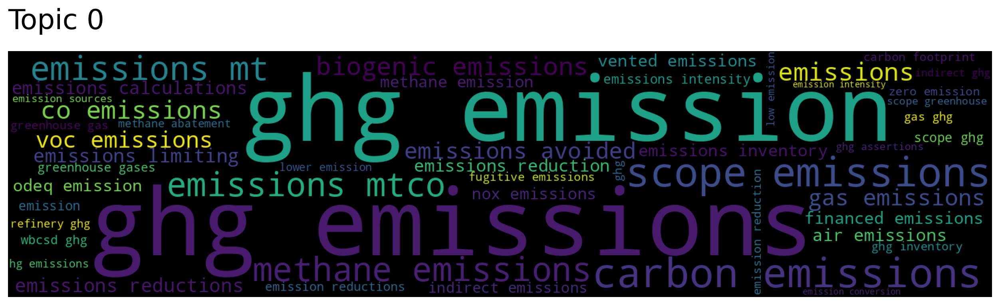

In [ ]:
topic_model.generate_topic_wordcloud(0)

In [ ]:
documents, document_scores, document_ids= topic_model.search_documents_by_topic(50,100)

In [ ]:
pd.DataFrame([documents, document_scores, document_ids], columns = None).T

,0,1,2
0,our esg working group comprises key functional...,0.797611,44489
1,the strategic direction and implementation of ...,0.797129,103968
2,executive leadership: management we have a cro...,0.795334,23671
3,"our executive team leads from the front, setti...",0.785995,70206
4,business units throughout the company are resp...,0.783751,57904
...,...,...,...
95,the monitoring of climate-related issues is al...,0.64282,9369
96,supporting the steering committee are four wor...,0.641742,103718
97,management level erm committee the erm committ...,0.641017,53443
98,the vp of esg's primary responsibility is to d...,0.640641,12067


In [ ]:
topics = topic_model.get_topics()[0]

In [ ]:
topicmapping[0]

[193, 121, 144, 145, 288, 167, 232, 1]

In [ ]:
topics[topicmapping[0]]

array([['methane emissions', 'methane emission', 'nox emissions',
        'ghg emissions', 'carbon emissions', 'air emissions',
        'co emissions', 'ghg emission', 'emissions avoided',
        'emissions mtco', 'emissions mt', 'voc emissions',
        'gas emissions', 'co methane', 'methane abatement', 'emissions',
        'emissions limiting', 'vented emissions', 'nitrogen oxide',
        'methane', 'biogenic emissions', 'odeq emission',
        'air pollutants', 'methane ch', 'nox sulfur', 'carbon monoxide',
        'carbon dioxide', 'nitrogen oxides', 'emissions reduction',
        'emissions calculations', 'scope emissions',
        'emissions reductions', 'emissions inventory',
        'methane intensity', 'emissions intensity', 'gases',
        'dioxide so', 'methane leak', 'gases included',
        'greenhouse gases', 'financed emissions', 'indirect emissions',
        'fugitive methane', 'emission', 'dioxide', 'air pollution',
        'sulfur dioxide', 'lower emission', 'fu

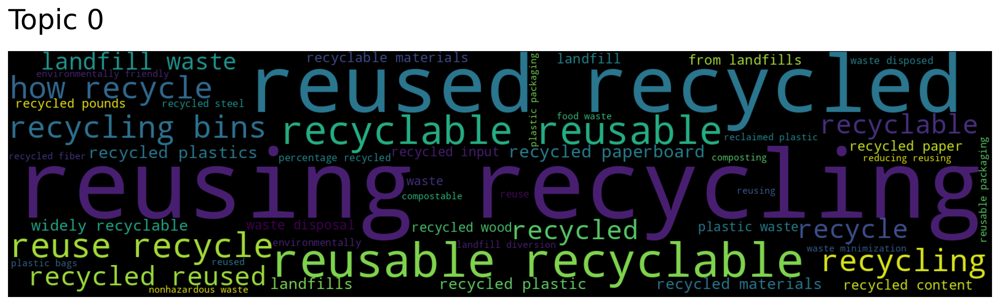

In [ ]:
topic_model.generate_topic_wordcloud(0)

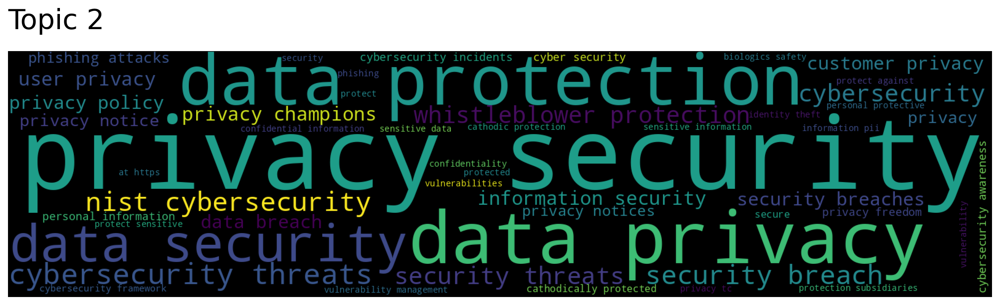

In [ ]:
topic_model.generate_topic_wordcloud(2)

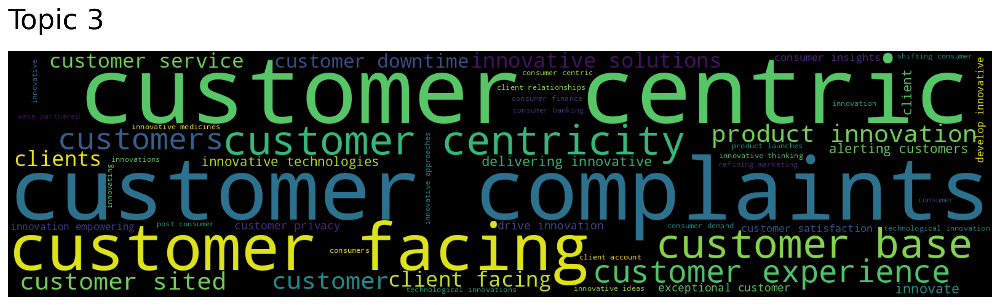

In [ ]:
topic_model.generate_topic_wordcloud(3)

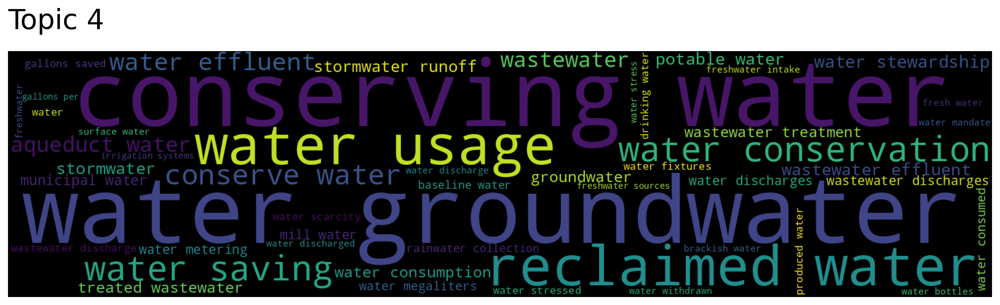

In [ ]:
topic_model.generate_topic_wordcloud(4)

In [ ]:
tlist = topic_model.topic_words

In [ ]:
dlist= []
for i in tlist:
  dlist.append(i[:4])

In [ ]:
pd.DataFrame(dlist).to_csv("top2vec.csv")

In [ ]:
l=['E',
'E',
'S',
'S',
'E',
'S',
'S',
'S',
'G',
'G',
'S',
'S',
'S',
'S',
'E',
'E',
'G']


In [ ]:
documents, document_scores, document_ids= topic_model.search_documents_by_topic(0,1000)

In [ ]:
pd.DataFrame([documents, document_scores, document_ids], columns = None).T

,0,1,2
0,we divert as much e-waste as possible from lan...,0.825526,99981
1,one of our most successful environmental initi...,0.801161,13240
2,we estimate that about 48% of our waste is div...,0.799703,96919
3,we are working to lessen our environmental imp...,0.797259,31693
4,wba continues to prioritize waste management a...,0.795229,105887
...,...,...,...
995,products categorized as not recyclable (5% of ...,0.546371,36353
996,"if recycling and/or reuse is not feasible, was...",0.54627,21808
997,we utilize a third-party utility bill manageme...,0.545783,73112
998,we seek opportunities to design new facilities...,0.545779,73499


In [ ]:
tdf=[]
for i in range(len(l)):
  documents, document_scores, document_ids= topic_model.search_documents_by_topic(i,1000)
  df= pd.DataFrame([documents, document_scores, document_ids], columns = None).T
  df['label']=l[i]
  tdf.append(df)


In [ ]:
df_train = pd.concat(tdf)

In [ ]:
df_train.columns= ['doc', 'score', 'id', 'label']

In [ ]:
df_train.to_pickle("testdftopic2vec_v1.pkl")

In [ ]:
df_train[df_train['score']>0.5]

,doc,score,id,label
0,we divert as much e-waste as possible from lan...,0.825526,99981,E
1,one of our most successful environmental initi...,0.801161,13240,E
2,we estimate that about 48% of our waste is div...,0.799703,96919,E
3,we are working to lessen our environmental imp...,0.797259,31693,E
4,wba continues to prioritize waste management a...,0.795229,105887,E
...,...,...,...,...
748,we will continue to challenge our team to be a...,0.501613,30106,G
749,"as a key partner for our customers, our produc...",0.501482,25723,G
750,accomplishments our regions are focused on ini...,0.501282,52785,G
751,we believe our combination of global scale and...,0.500698,33523,G


In [ ]:
df_train['label'].unique()

array(['E', 'S', 'G'], dtype=object)

In [ ]:
pd.read_pickle('alldf.pkl').to_csv("alldf.csv")